# Week 04 seminar: Finetuning.

In [1]:
import os
import time
import requests
from tqdm.auto import trange, tqdm
from copy import deepcopy
from collections import defaultdict

import numpy as np
import pandas as pd

# charts and display libs
from PIL import Image, ImageFile
import matplotlib.pyplot as plt
%matplotlib inline
from IPython.display import display, HTML

# pytorch
import torch
import torchvision
from torchvision import transforms
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Ensure that output below says `device=device(type='cuda')` - you will need CUDA for faster model runs
# If in Colab, we recommend that you go to Runtime -> Change Runtime Type -> GPU

print(f"{torch.__version__=}, {torchvision.__version__=}, {device=}, {torch.get_num_threads()=}")

torch.__version__='2.0.1+cu118', torchvision.__version__='0.15.2+cu118', device=device(type='cuda'), torch.get_num_threads()=1


## TorchVision

[Torchvision](https://pytorch.org/vision/main/index.html) - part of PyTorch library with convenient tools and data for deep learning in visual domain.
- contains a number of popular vision [datasets](https://pytorch.org/vision/stable/datasets.html)
- preprocessing [tools](https://pytorch.org/vision/stable/transforms.html)
- and most importantly, [pre-trained models](https://pytorch.org/vision/main/models.html).

# Datasets: Imagenet

![imagenet_tiles](https://i.imgur.com/n4QIrzF.jpeg)

Today we're going to use and fine-tune CNN based on weights pre-trained on ImageNet.

What is Imagenet?
- large size image classification dataset.
    - ImageNet-1K contains 1,281,167 training images, 50,000 validation images and 100,000 test images.
    - Full original dataset (ImageNet-21k) contains 14,197,122 images divided into 21,841 classes
    - Resolution varies, average resolution: 469x387 pixels
- built pre-2010 by [Fei-Fei Li](https://en.wikipedia.org/wiki/Fei-Fei_Li) at Princeton
- made very popular by ImageNet Large Scale Visual Recognition Challenge (ILSVRC). See AlexNet moment: [chart](https://www.researchgate.net/figure/ImageNet-Competition-Results-50_fig1_329975404), [wiki](https://en.wikipedia.org/wiki/AlexNet), [paper](https://proceedings.neurips.cc/paper_files/paper/2012/file/c399862d3b9d6b76c8436e924a68c45b-Paper.pdf)
-  still relevant; [accuracy history 2013 to date](https://paperswithcode.com/sota/image-classification-on-imagenet)
- More about Imagenet: http://image-net.org/,  https://en.wikipedia.org/wiki/ImageNet

In [2]:
# loading Imagenet class labels for interpreting classification results
LABELS_URL = "https://s3.amazonaws.com/deep-learning-models/image-models/imagenet_class_index.json"
imagenet_labels = {int(k):v[1] for k, v in requests.get(LABELS_URL).json().items()}
print(len(imagenet_labels), '\n', list(imagenet_labels.items())[:5])

1000 
 [(0, 'tench'), (1, 'goldfish'), (2, 'great_white_shark'), (3, 'tiger_shark'), (4, 'hammerhead')]


# Pretrained models: Resnet


Torchvision models classification models with benchmarks may be viewed [here.](https://pytorch.org/vision/main/models.html#classification)

For this seminar we're going to use Pytorch implementation of popular Resnet model.

In [3]:
# loading pretrained Resnet-18 model
from torchvision.models import resnet18, ResNet18_Weights

model = resnet18(weights=ResNet18_Weights.DEFAULT) # load model with best available weights
model = model.to(device)  # move the model to GPU if available
model.train(False);        # set the model to evaluation mode

Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth
100%|██████████| 44.7M/44.7M [00:00<00:00, 66.3MB/s]


In [4]:
# view the model structure. Familiar layers are combined into 4 blocks
# note the last LINEAR layer named 'fc' that converts embeddings of size 512 into logits for 1000 Imagenet classes
model

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

### testing the pretrained model 1
test output dimensions with dummy inputs<br>
note that model inputs have to be 4D: (batch_size, color_channes, height, width)<br>
output is a 2D tensor of logits (batch_size, number_of_classes)

In [5]:
dummy_x = torch.randn(5, 3, 224, 224, device=device)  # dummy batch of 5 'images' sized 224x224 with 3 channels, created on GPU
result = model(dummy_x)
assert result.shape == (5, 1000)   # output is a 2D tensor of logits (batch_size, number_of_classes)

### testing the pretrained model 2. Predict class probabilities.

(224, 224)


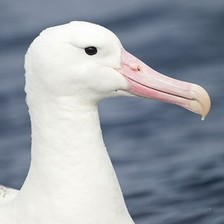

In [6]:
# loading image with PIL library
img = Image.open(requests.get('https://i.imgur.com/6CkG5KL.jpeg', stream=True).raw)
# img = Image.open('sample_images/albatross.jpg')  # alternative source
print(img.size)
img

In [7]:
# converting PIL image to torch.Tensor - detailed process
img_torch = torch.tensor(np.array(img), device=device)  # convert PIL image to np.array, then to torch.Tensor,
img_torch = img_torch.permute(2,0,1)  # reorder channels to move color to the front position, to match pytorch conventions
img_torch = img_torch / img_torch.max()  # scale to 0..1

img_torch.shape, img_torch.device, img_torch.min().item(), img_torch.max().item()  # verify shape, device and range

(torch.Size([3, 224, 224]),
 device(type='cuda', index=0),
 0.007843137718737125,
 1.0)

In [8]:
# converting PIL image to torch.Tensor - easy process
# PIL image to torch.Tensor can be converted with torchvision.transforms, equivalent to the above code (more details below)
img_torch = transforms.ToTensor()(img)
img_torch.shape, img_torch.max(), img_torch.min()

(torch.Size([3, 224, 224]), tensor(1.), tensor(0.0078))

In [9]:
# Predicting image class with pretrained model


def predict_img(img, model, top_n=5):
    if isinstance(img, str):
        Image.open(requests.get(url, stream=True).raw).convert('RGB')  # for loading images from url

    img_torch = transforms.ToTensor()(img)  # to torch.Tensor, reorder color channels, s|cale to 0..1
    img_torch = transforms.Resize((224, 224))(img_torch)      # another useful transform to resize images
    img_torch = img_torch.unsqueeze(0)                        # add batch dimension (remember that model needs 4D input)
    img_torch = img_torch.to(device)                          # moving the tensor to device (presumably cuda, in initialized above)
    prediction = model(img_torch)                             # obtain prediction logits from the model
    probs = torch.nn.functional.softmax(prediction, dim=-1)   # convert logits into probabilities
    probs = probs.cpu().data.numpy()                          # convert CUDA tensor to numpy array

    top_ix = probs.ravel().argsort()[-1: -top_n - 1: -1]      # get indices of most probable classes
    print (f'top-{top_n} classes:')                           # look up class label
    for l in top_ix:
        print (f"{probs.ravel()[l]:>6.2%}  {imagenet_labels[l].split(',')[0]}")


predict_img(img, model)

top-5 classes:
98.70%  albatross
 0.46%  spoonbill
 0.39%  American_egret
 0.19%  goose
 0.12%  crane


/usr/local/lib/python3.10/dist-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(


### testing the pretrained model 3: Images from unknown classes

Play with imahes from these and other (yours) URLS. Note how object outsize of imagenet classes confuse the net. Low probabilities in top classes are indications of model's low confidence.

(735, 979)


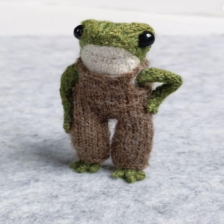

top-5 classes:
14.63%  teddy
 8.16%  tailed_frog
 5.86%  tree_frog
 3.63%  megalith
 3.07%  mongoose


In [10]:
url= 'https://i.imgur.com/F7ngojl.jpeg'                    # modern version

# <TRY ANY OTHER IMAGES YOU LIKE>

web_img = Image.open(requests.get(url, stream=True).raw).convert('RGB')
print(web_img.size)
display(transforms.Resize((224, 224))(web_img))
predict_img(web_img, model)

## More Torchvision tools: Transforms and transform pipelines¶

You already used `transforms.ToTensor` and `transforms.Resize` above. There are many more at [Torchvision](https://pytorch.org/vision/stable/transforms.html). For easier application they are typically combined into pipelines. See examples below.

For more advanced tranforms (faster and compatible with tasks requiring mask or reference points), check out [Albumentations library](https://albumentations.ai/).

In [11]:
from torchvision import transforms

# Typical transform pipeline for test loop
transform_pipeline = transforms.Compose([
    transforms.ToTensor(),
    transforms.Resize((224, 224)),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])  # Optional: normalize imaged according to ImageNet standards
])

img = Image.open(requests.get('https://i.imgur.com/6CkG5KL.jpeg', stream=True).raw)
# img = Image.open('sample_images/albatross.jpg')  # alt link
img_torch = transform_pipeline(img)

print(type(img_torch), img_torch.shape)

<class 'torch.Tensor'> torch.Size([3, 224, 224])


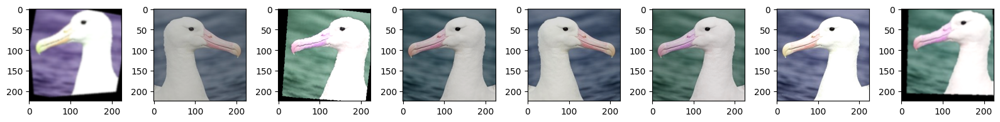

In [12]:
img = Image.open(requests.get('https://i.imgur.com/6CkG5KL.jpeg', stream=True).raw)
# img = Image.open('sample_images/albatross.jpg')  # alternative source

# Demo of augmentations for train pipeline

transform_pipeline_2 = transforms.Compose([
    transforms.RandomCrop((224, 224)),
    transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.2),
    transforms.RandomApply([
        transforms.RandomAffine(degrees=30, translate=(0.2, 0.2)),
        transforms.RandomRotation(30),
        transforms.GaussianBlur(kernel_size=25),
    ], p=0.5),
    transforms.RandomHorizontalFlip(),
    # transforms.RandomVerticalFlip(),  # not always applicable
    transforms.ToTensor(),
    # transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),  # Optional: normalizes imaged according to ImageNet standards
])

fig, axs = plt.subplots(1, 8, figsize=(16, 4))
for i, ax in enumerate(axs.ravel()):
    img_2 = transform_pipeline_2(img)
    ax.imshow(img_2.permute(1, 2, 0))
plt.tight_layout()

# Classifying with CNN model's latent features
Pretrained image classification models learn extract image features that are useful in classification tasks. We need to get those features from outputs of the model's penultimate level and pass them to classifier.
While this is not exactly a proper finetuning, this method is quick, rather robust and allows to classify unknown classes using quite small training sets (tens / hundreds of images).

### How to get features
features = activations before the very last Linear layer of the model (named `fc` in Resnet - check the model structure above.

During good old days in Torch7 you could access any intermediate output from the sequential model. Nowadays it's a bit more difficult though it's not Tensorflow where you need to compile another model for that. Here we're going to redefine the last layer... yes, to do nothing.

In [13]:
class Identity(torch.nn.Module):
    """replacement for the last model layer to deliver the unaltered inputs of the last layer"""

    def forward(self, x):
        return x

# it is practically same as torch.nn.Identity() - check https://pytorch.org/docs/stable/_modules/torch/nn/modules/linear.html#Identity

In [14]:
# Create model clone with altered last layer
embedding_model = deepcopy(model)  # start with a clone of the original model
embedding_model.fc = Identity()    # redefine the last layer to be Identity|
embedding_model = embedding_model.to(device)  # move the result to CUDA

In [15]:
img = Image.open(requests.get('https://i.imgur.com/6CkG5KL.jpeg', stream=True).raw)
# img = Image.open('sample_images/albatross.jpg') # alt link
img_torch = transforms.ToTensor()(img).unsqueeze(0).to(device)
out = embedding_model(img_torch).cpu().data.numpy()
assert out.shape == (1, 512), "your output for single image should have shape (1, 512)"

# Starter problem: cat-dog classification
Your next task is to use a pre-trained model to distinguish between cats and dogs.
- viewed as imposible in 2000
- popular data science challenge problem in 2010
- warm-up task for students in 2020s <br>
![cat_meme](https://i.imgur.com/u1bubWv.jpeg)

In [16]:
# download the dataset
!wget https://storage.yandexcloud.net/yandex-research/courses/dogs_vs_cats_1000.zip -O dogs_vs_cats_1000.zip

--2023-10-15 13:01:30--  https://storage.yandexcloud.net/yandex-research/courses/dogs_vs_cats_1000.zip
Resolving storage.yandexcloud.net (storage.yandexcloud.net)... 213.180.193.243, 2a02:6b8::1d9
Connecting to storage.yandexcloud.net (storage.yandexcloud.net)|213.180.193.243|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 46394659 (44M) [application/zip]
Saving to: ‘dogs_vs_cats_1000.zip’

dogs_vs_cats_1000.z 100%[===================>]  44.25M  13.3MB/s    in 3.3s    

2023-10-15 13:01:35 (13.3 MB/s) - ‘dogs_vs_cats_1000.zip’ saved [46394659/46394659]



In [17]:
!unzip -qn dogs_vs_cats_1000.zip
!ls dogs_vs_cats_1000 | wc -l  # should be 2000 images extracted

2000


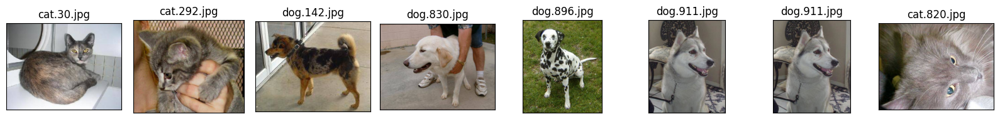

In [18]:
# Sample pets images
import random
fig, axs = plt.subplots(1, 8, figsize=(16, 2))

fnames = [fn for fn in os.listdir('dogs_vs_cats_1000')]
for ax, fname in zip(axs.ravel(), random.choices(fnames, k=8)):
    img_ = Image.open(os.path.join('dogs_vs_cats_1000', fname))
    ax.imshow(img_)
    ax.set_title(f"{fname}")
    ax.tick_params(left = False,labelleft = False , labelbottom = False, bottom = False)
plt.tight_layout()

In [19]:
# Here we generate image embeddings using the activations before the last layer
# use batches to accelerate the process

X_ = []  # storage for batches embeddings
Y_ = []  # storage for batches labels

filenames = [fname for fname in os.listdir('dogs_vs_cats_1000')]
batch_size = 64
x_batch_list = []  # to accumulate batch components

with torch.no_grad():
    for i, fname in enumerate(tqdm(filenames)):
        img = Image.open(os.path.join("dogs_vs_cats_1000", fname))
        img_torch = transforms.ToTensor()(img.resize((224, 224)))
        x_batch_list.append(img_torch)
        Y_.append(1 if fname.startswith("cat") else 0)

        if len(x_batch_list) == batch_size or i >= len(filenames) - 1:
            x_batch = torch.stack(x_batch_list).to(device)

            # use your embedding model to produce embeddings vectors, convert result to numpy array
            # embeddings = <YOUR CODE>
            embeddings = embedding_model(x_batch)
            assert isinstance(embeddings,  torch.Tensor)
            assert embeddings.ndim == 2 and embeddings.shape[1] == 512
            embeddings = embeddings.cpu().numpy()
            X_.append(embeddings)
            x_batch_list = []

  0%|          | 0/2000 [00:00<?, ?it/s]

In [20]:
X = np.concatenate(X_, axis = 0)  # concatenate all batches' embeddings into single 2D array.
Y = np.array(Y_[:len(X)])  # convert labels into np array; crop if we ended prematurely

print(X.shape, Y.shape, np.mean(Y))

assert X.ndim == 2 and X.shape[1] == 512
assert X.shape[0] == len(filenames)
assert Y.ndim == 1 and Y.shape[0] == X.shape[0]
assert 0.49 <= np.mean(Y) <= 0.51

(2000, 512) (2000,) 0.5


### embeddings classification with ML-1 tools

In [21]:
from sklearn.ensemble import RandomForestClassifier, ExtraTreesClassifier, GradientBoostingClassifier, AdaBoostClassifier
from sklearn.linear_model import LogisticRegression, RidgeClassifier
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier

* Train sklearn model, evaluate validation accuracy (should be >90%)

__Task 1 (2 points)__:<br>  
- write the code for cats/dogs classification using the embeddings created above. Use any classification tools that you learned. Reach at least 95% accuracy. __(1 point)__.  Try few different tools if accuracy is not high enough. <br>
(You may choose any classifier algorithm as long as it gets above 95% accuracy. To get the max grade here, you need to tune main hyperparameters of your chosen algorithm (e.g. k for KNN, tree depth, logreg C) depending on how many data points you have. )
- try this excercise with much smaller training set. Find the lowest train set size that you can at which you can still predict cat/dog class with 95% accuracy __(1 point)__ <br>
(note: exact threshold may depend on algorightm choice and train/test split. Show your effort in  experimenting with low train set sizes.)

In [22]:
%%time
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.1)
def evaluate_classifier(clf):
    clf.fit(X_train, Y_train)
    Y_pred = clf.predict(X_test)
    accuracy = clf.score(X_test, Y_test)
    print(f"{clf.__class__.__name__}")
    print(f"accuracy = {(Y_pred == Y_test).sum() / Y_pred.shape[0]:.1%}")
    return accuracy

classifiers = [
    RandomForestClassifier(),
    ExtraTreesClassifier(),
    GradientBoostingClassifier(),
    AdaBoostClassifier(),
    LogisticRegression(max_iter=10000),
    RidgeClassifier(),
    SVC(),
    DecisionTreeClassifier(),
    KNeighborsClassifier()
]

for classifier in classifiers:
    evaluate_classifier(classifier)



RandomForestClassifier
accuracy = 93.5%
ExtraTreesClassifier
accuracy = 94.0%
GradientBoostingClassifier
accuracy = 95.0%
AdaBoostClassifier
accuracy = 94.0%
LogisticRegression
accuracy = 97.5%
RidgeClassifier
accuracy = 94.5%
SVC
accuracy = 96.5%
DecisionTreeClassifier
accuracy = 88.5%
KNeighborsClassifier
accuracy = 95.0%
CPU times: user 39.9 s, sys: 343 ms, total: 40.2 s
Wall time: 42.5 s


In [24]:
successful_n = None

best_classifier = LogisticRegression(max_iter=10000)

for size in np.arange(100, 2000,100):
    X_train, X_test, Y_train, Y_test = train_test_split(X, Y, train_size=size)

    accuracy = evaluate_classifier(best_classifier)
    print(f"Training size = {size} images with Accuracy = {accuracy:.4f}")

    if accuracy >= 0.95:
        successful_n = size
        print(f"Lowest training set size = {size} images")
        break

LogisticRegression
accuracy = 94.2%
Training size = 100 images with Accuracy = 0.9416
LogisticRegression
accuracy = 95.7%
Training size = 200 images with Accuracy = 0.9567
Lowest training set size = 200 images


In [29]:
successful_n = None

best_classifier = LogisticRegression(max_iter=10000)

for size in np.arange(10, 200,1):
    X_train, X_test, Y_train, Y_test = train_test_split(X, Y, train_size=size)

    accuracy = evaluate_classifier(best_classifier)
    print(f"Training size = {size} images with Accuracy = {accuracy:.4f}")

    if accuracy >= 0.95:
        successful_n = size
        print(f"Lowest training set size = {size} images")
        break

LogisticRegression
accuracy = 90.8%
Training size = 10 images with Accuracy = 0.9075
LogisticRegression
accuracy = 87.8%
Training size = 11 images with Accuracy = 0.8778
LogisticRegression
accuracy = 90.6%
Training size = 12 images with Accuracy = 0.9059
LogisticRegression
accuracy = 92.5%
Training size = 13 images with Accuracy = 0.9245
LogisticRegression
accuracy = 92.3%
Training size = 14 images with Accuracy = 0.9230
LogisticRegression
accuracy = 91.5%
Training size = 15 images with Accuracy = 0.9154
LogisticRegression
accuracy = 91.6%
Training size = 16 images with Accuracy = 0.9163
LogisticRegression
accuracy = 79.3%
Training size = 17 images with Accuracy = 0.7932
LogisticRegression
accuracy = 90.0%
Training size = 18 images with Accuracy = 0.8996
LogisticRegression
accuracy = 92.4%
Training size = 19 images with Accuracy = 0.9238
LogisticRegression
accuracy = 92.2%
Training size = 20 images with Accuracy = 0.9222
LogisticRegression
accuracy = 91.7%
Training size = 21 images wit

## The minimal training size somehow depends on random split process. We get 30 as minimal size here which means a possible one only.

## Torchvision Datasets
- Built-in datasets https://pytorch.org/vision/stable/datasets.html#built-in-datasets

- Datasets and Dataloaders at `torch.utils.data`: https://pytorch.org/tutorials/beginner/basics/data_tutorial.html

- Torchvision classes for custom datasets  https://pytorch.org/vision/stable/datasets.html#base-classes-for-custom-datasets

# Problem 2: Clasification of cat/dog breeds using Oxford pets dataset

The next problem is to classify specific cat / dog breeds from popular Oxford pets dataset. It is conveniently provided by Pytorch so loading and using it is very easy.

Dataset home page: https://www.robots.ox.ac.uk/~vgg/data/pets/

Available from Pytorch: https://pytorch.org/vision/stable/generated/torchvision.datasets.OxfordIIITPet.html#torchvision.datasets.OxfordIIITPet



In [ ]:
# Loading train and test subsets of the dataset
# using simple transform for both slices

test_transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Resize((224, 224), antialias=True),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

train_dataset = torchvision.datasets.OxfordIIITPet(root='.', split='trainval', target_types='category', download=True, transform=test_transform)
test_dataset = torchvision.datasets.OxfordIIITPet(root='.', split='test', target_types='category', download=True, transform=test_transform)

print("dataset sizes:", len(train_dataset), len(test_dataset))

print(train_dataset.classes)

100%|██████████| 791918971/791918971 [00:35<00:00, 22445916.24it/s]


Extracting oxford-iiit-pet/images.tar.gz to oxford-iiit-pet


100%|██████████| 19173078/19173078 [00:01<00:00, 10563096.23it/s]


Extracting oxford-iiit-pet/annotations.tar.gz to oxford-iiit-pet
dataset sizes: 3680 3669
['Abyssinian', 'American Bulldog', 'American Pit Bull Terrier', 'Basset Hound', 'Beagle', 'Bengal', 'Birman', 'Bombay', 'Boxer', 'British Shorthair', 'Chihuahua', 'Egyptian Mau', 'English Cocker Spaniel', 'English Setter', 'German Shorthaired', 'Great Pyrenees', 'Havanese', 'Japanese Chin', 'Keeshond', 'Leonberger', 'Maine Coon', 'Miniature Pinscher', 'Newfoundland', 'Persian', 'Pomeranian', 'Pug', 'Ragdoll', 'Russian Blue', 'Saint Bernard', 'Samoyed', 'Scottish Terrier', 'Shiba Inu', 'Siamese', 'Sphynx', 'Staffordshire Bull Terrier', 'Wheaten Terrier', 'Yorkshire Terrier']


In [ ]:
# create dataloaders to repack the datasets' data into batches
# read more

batch_size = 64
train_dataloader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_dataloader = torch.utils.data.DataLoader(test_dataset, batch_size=batch_size, shuffle=False)
print("dataloader sizes:", len(train_dataloader), len(test_dataloader))

dataloader sizes: 58 58


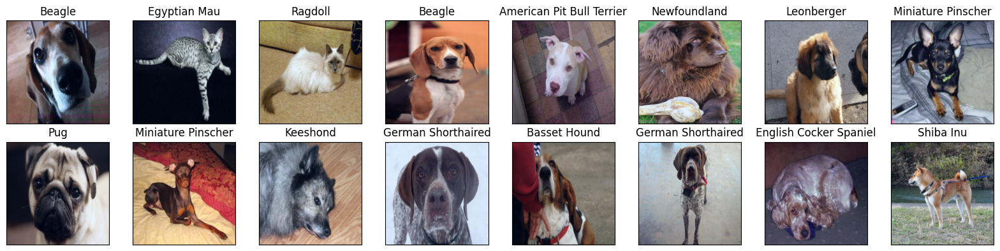

In [ ]:
# Showing sample pets images
for x_batch, y_batch in train_dataloader:
    break  # Only get data from the 1st batch for now

fig, axs = plt.subplots(2, 8, figsize=(16, 4))
for i, ax in enumerate(axs.ravel()):
    img_ = x_batch[i].permute(1, 2, 0) # restoring dimensions order
    img_ -= img_.min().item()  # normalizing image to 0..1
    img_ /= img_.max().item()
    ax.imshow(img_)
    label = train_dataset.classes[y_batch[i]]
    ax.set_title(f"{label}")
    ax.tick_params(left=False, labelleft=False, labelbottom=False, bottom=False)
plt.tight_layout()

Remember that Imagenet includes quite a few cat and dog breeds among its classes.

Let's try to predcit breeds with Imagenet-pretrained model without finetuning first

In [ ]:
# Predicting breeds with Imagenet-pretrained model
Y_probs, Y_true = [], []
for x_batch, y_batch in tqdm(test_dataloader):
    with torch.no_grad():
        prediction = model(x_batch.to(device))
        probs = torch.nn.functional.softmax(prediction, dim=-1).cpu()
        Y_true.append(y_batch)
        Y_probs.append(probs)

Y_probs = torch.cat(Y_probs, axis=0)  # tensor with class probabilities
Y_true = torch.cat(Y_true)
Y_true.shape, Y_probs.shape

  0%|          | 0/58 [00:00<?, ?it/s]

(torch.Size([3669]), torch.Size([3669, 1000]))

In [ ]:
# Output top 3 predictions for each class using pretrained CNN (no finetuning)
# Expect to see high accuracy (70-80%) in some classes, much lower overal, mismatch in label spaces.

results_list = {}

for i, cl in enumerate(test_dataset.classes):
    class_stats = {"true_label":cl}
    probs1 = Y_probs[np.where(Y_true == i)].mean(axis=0).numpy()
    top_ix = probs1.argsort()[-1:][::-1]
    class_stats
    for j, l in enumerate(top_ix):
        class_stats = {f"pred_1": imagenet_labels[l],
                    f"prob_{1}": probs1.ravel()[l]}
    results_list[cl] = class_stats

df = pd.DataFrame(results_list).T.sort_values('prob_1', ascending=False)
float_cols = ['prob_1']
df.style.format('{:.2%}', subset=float_cols)

,pred_1,prob_1
Siamese,Siamese_cat,94.51%
Keeshond,keeshond,94.35%
Saint Bernard,Saint_Bernard,90.23%
Persian,Persian_cat,87.12%
Pomeranian,Pomeranian,85.34%
Pug,pug,84.19%
Samoyed,Samoyed,82.18%
Boxer,boxer,82.16%
Egyptian Mau,Egyptian_cat,82.02%
Leonberger,Leonberg,82.00%


### Finetuning CNN: classification layer only:

__Task 2: (3 points)__:<br>
Complete the code below and reach at least 85% accuracy by training only the classification layer:

In [ ]:
ft_model = deepcopy(model).to(device)

for param in ft_model.parameters():
    param.requires_grad = False

num_classes = len(train_dataset.classes)
print(ft_model.fc.in_features, num_classes)
ft_model.fc = torch.nn.Linear(ft_model.fc.in_features, num_classes).to(device)

for param in ft_model.fc.parameters():
    param.requires_grad = True

print(device)
print(ft_model.fc.weight.device)

assert all(not p.requires_grad for p in ft_model.parameters() if p not in set(ft_model.fc.parameters()))
assert ft_model.fc.out_features == len(train_dataset.classes)
#assert ft_model.fc.weight.device == device, f"ft_model.fc must be on {device}"
assert ft_model.fc.weight.requires_grad

criterion = torch.nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(ft_model.parameters(), lr=0.001)

512 37
cuda
cuda:0


In [ ]:
# train the finetuning model in a standard training loop.
num_epochs = 20  # Adjust number of epochs if needed

history = defaultdict(list)
for epoch in range(num_epochs):
    start_time = time.time()

    ft_model.train()
    train_losses = []
    pbar = tqdm(train_dataloader, leave=False)
    for x_batch, y_batch in pbar:

        # calculate model predictions, calculate loss, make optimizer step
        x_batch, y_batch = x_batch.to(device), y_batch.to(device)
        optimizer.zero_grad()
        y_pred = ft_model(x_batch)
        loss = criterion(y_pred, y_batch)
        loss.backward()
        optimizer.step()

        train_losses.append(loss.item())
        pbar.desc = f"Train. Ep:{epoch}, Loss:{np.mean(train_losses[-10:]):.5f}"

    ft_model.eval()
    val_losses = []
    val_cnt, val_correct = 0, 0
    pbar = tqdm(test_dataloader, leave=False)
    for x_batch, y_batch in pbar:

        # get model predictions, measure loss, collect data for accuracy calc
        x_batch, y_batch = x_batch.to(device), y_batch.to(device)
        y_pred = ft_model(x_batch)
        loss = criterion(y_pred, y_batch)

        val_losses.append(loss.item())
        val_cnt += y_batch.shape[0]
        val_correct += (y_batch.cuda() == torch.argmax(y_pred, dim=1)).sum().item()
        pbar.desc = f"Valid. Ep:{epoch}, Loss:{np.mean(val_losses):.5f}"

    train_loss = np.mean(train_losses)
    val_loss = np.mean(val_losses)
    accuracy = val_correct / val_cnt
    history['train_loss'].append(train_loss)
    history['val_loss'].append(val_loss)
    history['accuracy'].append(accuracy)
    print(f"Ep.{epoch:>2}: {train_loss=:.5f}  {val_loss=:.5f}  {accuracy=:.2%}  epoch_time={time.time() - start_time:.1f}s")

    if epoch > 2 and history['accuracy'][-1] < max(history['accuracy']):
        break
print(f"Best Accuracy = {max(history['accuracy']):.2%}")

  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep. 0: train_loss=2.25184  val_loss=1.26986  accuracy=74.00%  epoch_time=46.7s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep. 1: train_loss=0.92433  val_loss=0.75302  accuracy=84.71%  epoch_time=45.1s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep. 2: train_loss=0.60284  val_loss=0.61684  accuracy=85.34%  epoch_time=45.3s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep. 3: train_loss=0.47506  val_loss=0.53664  accuracy=86.75%  epoch_time=45.7s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep. 4: train_loss=0.39594  val_loss=0.49565  accuracy=87.41%  epoch_time=44.7s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep. 5: train_loss=0.33836  val_loss=0.47599  accuracy=87.00%  epoch_time=45.3s
Best Accuracy = 87.41%


In [ ]:
# This part of finetuning alone should deliver at least 85% accuracy.
assert accuracy > 0.85

In [ ]:
# Predicting breeds with finetuned model

Y_probs, Y_true = [], []
for x_batch, y_batch in tqdm(test_dataloader):
    with torch.no_grad():
        prediction = ft_model(x_batch.to(device))
        probs = torch.nn.functional.softmax(prediction, dim=-1).cpu()
        Y_true.append(y_batch)
        Y_probs.append(probs)

Y_probs = torch.cat(Y_probs, axis=0)
Y_true = torch.cat(Y_true)
Y_true.shape, Y_probs.shape

  0%|          | 0/58 [00:00<?, ?it/s]

(torch.Size([3669]), torch.Size([3669, 37]))

In [ ]:
# Measure Top1 prediction accuracy for each class

results_list = {}
total, correct = 0, 0

for i, cl in enumerate(test_dataset.classes):
    class_preds = np.where(Y_true == i)
    probs1 = Y_probs[class_preds].mean(axis=0).numpy()
    acc1 = probs1[i]
    class_stats = {"true_label":cl, 'acc1': acc1}
    total += class_preds[0].shape[0]
    correct += class_preds[0].shape[0] * acc1
    results_list[cl] = acc1

df = pd.Series(results_list).to_frame('acc1').sort_values('acc1', ascending=False)
df.style.format('{:.2%}', subset=['acc1'])

,acc1
Samoyed,90.76%
Keeshond,89.47%
Japanese Chin,89.32%
German Shorthaired,88.22%
Scottish Terrier,87.63%
Newfoundland,87.30%
Leonberger,86.37%
Havanese,86.00%
Pomeranian,83.80%
Shiba Inu,83.62%


In [ ]:
print(f"Overall Accuracy = {correct / total:.2%}")  # macro-averaged accuracy

Overall Accuracy = 73.08%


### Finetuning CNN: now unfreeze and train all layers:

__task 3 (5 points)__: Based on the previous task, continue finetuning the model run by training all of its layers. Obtain at least 90% accuracy (macro average, as defined in the code).
To reach 90%, you will need to experiment with network and/or training code, start from using improvements from the list below:

Scoring:
- reaching 90% accuracy - __3 points__
- testing out all 4 of these improvements - __2 points__:
    - Hyperparameters optimization
    - Image augmentation
    - Pretrained model selection
    - Early stopping training at epoch with best metric and / or loading the weights of best epoch. [read about `state_dict`](https://pytorch.org/tutorials/beginner/saving_loading_models.html#what-is-a-state-dict)
    
(you may not necessarily get spectacular results right away. Experiment and describe your actions and findings in a brief report in this notebook.)
- scoring above 90% -- __+1 BONUS point__ for every 1% improvement in accuracy above 90%

__Guidelines__: to improve quality of the finetuned model we can now train all of its layers.
- do this after initial training of classification layer
- set learning rate to much lower level to avoid explosion
- make all layers trainable using `requires_grad` param

In [ ]:
# Continue training with all layers involved

# <YOUR CODE to make all layers trainable>

for param in ft_model.parameters():
    param.requires_grad = True

assert all (p.requires_grad for p in ft_model.parameters())

optimizer = torch.optim.Adam(ft_model.parameters(), lr=0.00003)  # reduce LR to avoid explosion

In [ ]:
# train the finetuning model in a standard training loop.
num_epochs = 20  # Adjust number of epochs if needed

history = defaultdict(list)
for epoch in range(num_epochs):
    start_time = time.time()

    ft_model.train()
    train_losses = []
    pbar = tqdm(train_dataloader, leave=False)
    for x_batch, y_batch in pbar:

        # calculate model predictions, calculate loss, make optimizer step
        x_batch, y_batch = x_batch.to(device), y_batch.to(device)
        optimizer.zero_grad()
        y_pred = ft_model(x_batch)
        loss = criterion(y_pred, y_batch)
        loss.backward()
        optimizer.step()

        train_losses.append(loss.item())
        pbar.desc = f"Train. Ep:{epoch}, Loss:{np.mean(train_losses[-10:]):.5f}"

    ft_model.eval()
    val_losses = []
    val_cnt, val_correct = 0, 0
    pbar = tqdm(test_dataloader, leave=False)
    for x_batch, y_batch in pbar:

        # get model predictions, measure loss, collect data for accuracy calc
        x_batch, y_batch = x_batch.to(device), y_batch.to(device)
        y_pred = ft_model(x_batch)
        loss = criterion(y_pred, y_batch)

        val_losses.append(loss.item())
        val_cnt += y_batch.shape[0]
        val_correct += (y_batch.cuda() == torch.argmax(y_pred, dim=1)).sum().item()
        pbar.desc = f"Valid. Ep:{epoch}, Loss:{np.mean(val_losses):.5f}"

    train_loss = np.mean(train_losses)
    val_loss = np.mean(val_losses)
    accuracy = val_correct / val_cnt
    history['train_loss'].append(train_loss)
    history['val_loss'].append(val_loss)
    history['accuracy'].append(accuracy)
    print(f"Ep.{epoch:>2}: {train_loss=:.5f}  {val_loss=:.5f}  {accuracy=:.2%}  epoch_time={time.time() - start_time:.1f}s")

    if epoch > 2 and history['accuracy'][-1] < max(history['accuracy']):
        break
print(f"Best Accuracy = {max(history['accuracy']):.2%}")

  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep. 0: train_loss=0.26623  val_loss=0.37906  accuracy=89.23%  epoch_time=52.2s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep. 1: train_loss=0.11724  val_loss=0.36490  accuracy=89.53%  epoch_time=50.4s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep. 2: train_loss=0.06836  val_loss=0.35468  accuracy=89.37%  epoch_time=50.4s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep. 3: train_loss=0.04430  val_loss=0.34028  accuracy=89.83%  epoch_time=50.0s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep. 4: train_loss=0.03214  val_loss=0.33469  accuracy=89.92%  epoch_time=49.8s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep. 5: train_loss=0.02491  val_loss=0.33479  accuracy=89.83%  epoch_time=48.3s
Best Accuracy = 89.92%


In [ ]:
# Predicting breeds with finetuned model

Y_probs, Y_true = [], []
for x_batch, y_batch in tqdm(test_dataloader):
    with torch.no_grad():
        prediction = ft_model(x_batch.to(device))
        probs = torch.nn.functional.softmax(prediction, dim=-1).cpu()
        Y_true.append(y_batch)
        Y_probs.append(probs)

Y_probs = torch.cat(Y_probs, axis=0)
Y_true = torch.cat(Y_true)
Y_true.shape, Y_probs.shape

# Measure Top1 prediction accuracy for each class

results_list = {}
total, correct = 0, 0

for i, cl in enumerate(test_dataset.classes):
    class_preds = np.where(Y_true == i)
    probs1 = Y_probs[class_preds].mean(axis=0).numpy()
    acc1 = probs1[i]
    class_stats = {"true_label":cl, 'acc1': acc1}
    total += class_preds[0].shape[0]
    correct += class_preds[0].shape[0] * acc1
    results_list[cl] = acc1

df = pd.Series(results_list).to_frame('acc1').sort_values('acc1', ascending=False)
df.style.format('{:.2%}', subset=['acc1'])


  0%|          | 0/58 [00:00<?, ?it/s]

,acc1
Samoyed,95.85%
Keeshond,95.83%
Scottish Terrier,95.38%
German Shorthaired,95.25%
Japanese Chin,93.94%
Shiba Inu,93.03%
Saint Bernard,92.87%
Leonberger,92.77%
Newfoundland,90.70%
Havanese,89.96%


In [ ]:
print(f"Overall Accuracy = {correct / total:.2%}")  # macro-averaged accuracy

Overall Accuracy = 83.19%


## Retrain from scratch

In [ ]:
train_transform = transforms.Compose([
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(10),
    transforms.RandomResizedCrop(224, scale=(0.8, 1.0)),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406],
                         [0.229, 0.224, 0.225])
])


test_transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Resize((224, 224), antialias=True),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])


train_dataset = torchvision.datasets.OxfordIIITPet(root='.',
                                                   split='trainval',
                                                   target_types='category',
                                                   download=True,
                                                   transform=train_transform)
test_dataset = torchvision.datasets.OxfordIIITPet(root='.',
                                                  split='test',
                                                  target_types='category',
                                                  download=True,
                                                  transform=test_transform)

print("dataset sizes:", len(train_dataset), len(test_dataset))

print(len(train_dataset.classes))

dataset sizes: 3680 3669
37


In [ ]:
# create dataloaders to repack the datasets' data into batches
# read more

batch_size = 64
train_dataloader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_dataloader = torch.utils.data.DataLoader(test_dataset, batch_size=batch_size, shuffle=False)
print("dataloader sizes:", len(train_dataloader), len(test_dataloader))

dataloader sizes: 58 58


In [ ]:
from torchvision.models import resnet50, ResNet50_Weights

model = resnet50(weights=ResNet50_Weights.DEFAULT) # load model with best available weights
model = model.to(device)  # move the model to GPU if available
model.train(False);

Downloading: "https://download.pytorch.org/models/resnet50-11ad3fa6.pth" to /root/.cache/torch/hub/checkpoints/resnet50-11ad3fa6.pth
100%|██████████| 97.8M/97.8M [00:01<00:00, 90.1MB/s]


In [ ]:
new_model = deepcopy(model).to(device)

for param in new_model.parameters():
    param.requires_grad = False

num_classes = len(train_dataset.classes)
print(new_model.fc.in_features, num_classes)
new_model.fc = torch.nn.Linear(new_model.fc.in_features, num_classes).to(device)

for param in new_model.fc.parameters():
    param.requires_grad = True

print(device)
print(new_model.fc.weight.device)

assert all(not p.requires_grad for p in new_model.parameters() if p not in set(new_model.fc.parameters()))
assert new_model.fc.out_features == len(train_dataset.classes)
#assert new_model.fc.weight.device == device, f"new_model.fc must be on {device}"
assert new_model.fc.weight.requires_grad

criterion = torch.nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(new_model.parameters(), lr=6.41E-04)#

2048 37
cuda
cuda:0


In [ ]:
# train the finetuning model in a standard training loop.
num_epochs = 50  # Adjust number of epochs if needed

history = defaultdict(list)
patience = 5
early_stop_counter = 0
best_accuracy = 0.0
best_model_wts = deepcopy(new_model.state_dict())

history = defaultdict(list)
for epoch in range(num_epochs):
    start_time = time.time()

    new_model.train()
    train_losses = []
    pbar = tqdm(train_dataloader, leave=False)
    for x_batch, y_batch in pbar:

        # calculate model predictions, calculate loss, make optimizer step
        x_batch, y_batch = x_batch.to(device), y_batch.to(device)
        optimizer.zero_grad()
        y_pred = new_model(x_batch)
        loss = criterion(y_pred, y_batch)
        loss.backward()
        optimizer.step()

        train_losses.append(loss.item())
        pbar.desc = f"Train. Ep:{epoch}, Loss:{np.mean(train_losses[-10:]):.5f}"

    new_model.eval()
    val_losses = []
    val_cnt, val_correct = 0, 0
    pbar = tqdm(test_dataloader, leave=False)
    for x_batch, y_batch in pbar:

        # get model predictions, measure loss, collect data for accuracy calc
        x_batch, y_batch = x_batch.to(device), y_batch.to(device)
        y_pred = new_model(x_batch)
        loss = criterion(y_pred, y_batch)

        val_losses.append(loss.item())
        val_cnt += y_batch.shape[0]
        val_correct += (y_batch.cuda() == torch.argmax(y_pred, dim=1)).sum().item()
        pbar.desc = f"Valid. Ep:{epoch}, Loss:{np.mean(val_losses):.5f}"

    train_loss = np.mean(train_losses)
    val_loss = np.mean(val_losses)
    accuracy = val_correct / val_cnt
    history['train_loss'].append(train_loss)
    history['val_loss'].append(val_loss)
    history['accuracy'].append(accuracy)
    print(f"Ep.{epoch:>2}: {train_loss=:.5f}  {val_loss=:.5f}  {accuracy=:.2%}  epoch_time={time.time() - start_time:.1f}s")

    if accuracy > best_accuracy:
        best_accuracy = accuracy
        best_model_wts = deepcopy(new_model.state_dict())
        early_stop_counter = 0
    else:
        early_stop_counter += 1
        if early_stop_counter >= patience:
            print("Early stopping triggered.")
            break

new_model.load_state_dict(best_model_wts)

print(f"Best Accuracy = {max(history['accuracy']):.2%}")

  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep. 0: train_loss=2.66358  val_loss=1.96858  accuracy=79.64%  epoch_time=55.0s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep. 1: train_loss=1.35293  val_loss=1.19514  accuracy=85.47%  epoch_time=55.0s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep. 2: train_loss=0.79792  val_loss=0.85161  accuracy=87.14%  epoch_time=55.8s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep. 3: train_loss=0.55603  val_loss=0.68516  accuracy=88.09%  epoch_time=55.3s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep. 4: train_loss=0.42108  val_loss=0.58131  accuracy=88.72%  epoch_time=54.5s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep. 5: train_loss=0.34133  val_loss=0.52742  accuracy=89.13%  epoch_time=54.9s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep. 6: train_loss=0.28734  val_loss=0.48294  accuracy=89.13%  epoch_time=55.6s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep. 7: train_loss=0.25291  val_loss=0.44233  accuracy=89.45%  epoch_time=54.1s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep. 8: train_loss=0.21981  val_loss=0.43227  accuracy=89.34%  epoch_time=54.7s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep. 9: train_loss=0.19984  val_loss=0.40110  accuracy=89.86%  epoch_time=54.4s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep.10: train_loss=0.17849  val_loss=0.39199  accuracy=89.78%  epoch_time=54.1s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep.11: train_loss=0.16479  val_loss=0.37155  accuracy=90.02%  epoch_time=55.5s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep.12: train_loss=0.14936  val_loss=0.36865  accuracy=90.19%  epoch_time=54.9s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep.13: train_loss=0.13542  val_loss=0.35511  accuracy=90.41%  epoch_time=55.7s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep.14: train_loss=0.12604  val_loss=0.34541  accuracy=90.35%  epoch_time=55.6s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep.15: train_loss=0.11562  val_loss=0.34624  accuracy=90.16%  epoch_time=55.4s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep.16: train_loss=0.10657  val_loss=0.33774  accuracy=90.22%  epoch_time=54.0s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep.17: train_loss=0.10298  val_loss=0.33025  accuracy=90.38%  epoch_time=55.5s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep.18: train_loss=0.09410  val_loss=0.32831  accuracy=90.57%  epoch_time=55.4s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep.19: train_loss=0.08777  val_loss=0.32312  accuracy=90.49%  epoch_time=55.8s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep.20: train_loss=0.08180  val_loss=0.31848  accuracy=90.46%  epoch_time=54.9s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep.21: train_loss=0.08361  val_loss=0.32074  accuracy=90.19%  epoch_time=54.4s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep.22: train_loss=0.07561  val_loss=0.31914  accuracy=90.52%  epoch_time=53.9s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep.23: train_loss=0.07100  val_loss=0.30991  accuracy=90.68%  epoch_time=55.4s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep.24: train_loss=0.06633  val_loss=0.31224  accuracy=90.38%  epoch_time=55.2s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep.25: train_loss=0.06306  val_loss=0.30656  accuracy=90.52%  epoch_time=55.0s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep.26: train_loss=0.06165  val_loss=0.31113  accuracy=90.65%  epoch_time=54.6s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep.27: train_loss=0.05617  val_loss=0.31041  accuracy=90.24%  epoch_time=54.4s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep.28: train_loss=0.05438  val_loss=0.30577  accuracy=90.38%  epoch_time=54.7s
Early stopping triggered.
Best Accuracy = 90.68%


In [ ]:
# Predicting breeds with finetuned model

Y_probs, Y_true = [], []
for x_batch, y_batch in tqdm(test_dataloader):
    with torch.no_grad():
        prediction = new_model(x_batch.to(device))
        probs = torch.nn.functional.softmax(prediction, dim=-1).cpu()
        Y_true.append(y_batch)
        Y_probs.append(probs)

Y_probs = torch.cat(Y_probs, axis=0)
Y_true = torch.cat(Y_true)
Y_true.shape, Y_probs.shape

# Measure Top1 prediction accuracy for each class

results_list = {}
total, correct = 0, 0

for i, cl in enumerate(test_dataset.classes):
    class_preds = np.where(Y_true == i)
    probs1 = Y_probs[class_preds].mean(axis=0).numpy()
    acc1 = probs1[i]
    class_stats = {"true_label":cl, 'acc1': acc1}
    total += class_preds[0].shape[0]
    correct += class_preds[0].shape[0] * acc1
    results_list[cl] = acc1

df = pd.Series(results_list).to_frame('acc1').sort_values('acc1', ascending=False)
df.style.format('{:.2%}', subset=['acc1'])


  0%|          | 0/58 [00:00<?, ?it/s]

,acc1
Leonberger,97.28%
Samoyed,97.07%
Japanese Chin,96.22%
German Shorthaired,96.06%
Shiba Inu,96.03%
Scottish Terrier,93.71%
Keeshond,93.57%
Saint Bernard,93.53%
Yorkshire Terrier,93.18%
Great Pyrenees,92.81%


In [ ]:
print(f"Overall Accuracy = {correct / total:.2%}")  # macro-averaged accuracy

Overall Accuracy = 83.55%


In [ ]:
unfreeze_model = deepcopy(new_model).to(device)

In [ ]:
# Continue training with all layers involved

# <YOUR CODE to make all layers trainable>

for param in unfreeze_model.parameters():
    param.requires_grad = True

assert all (p.requires_grad for p in unfreeze_model.parameters())

optimizer = torch.optim.Adam(unfreeze_model.parameters(), lr= 2.64E-05)  # reduce LR to avoid explosion

In [ ]:
# train the finetuning model in a standard training loop.
num_epochs = 50  # Adjust number of epochs if needed

history = defaultdict(list)
patience = 5
early_stop_counter = 0
best_accuracy = 0.0
best_model_wts = deepcopy(unfreeze_model.state_dict())

history = defaultdict(list)
for epoch in range(num_epochs):
    start_time = time.time()

    unfreeze_model.train()
    train_losses = []
    pbar = tqdm(train_dataloader, leave=False)
    for x_batch, y_batch in pbar:

        # calculate model predictions, calculate loss, make optimizer step
        x_batch, y_batch = x_batch.to(device), y_batch.to(device)
        optimizer.zero_grad()
        y_pred = unfreeze_model(x_batch)
        loss = criterion(y_pred, y_batch)
        loss.backward()
        optimizer.step()

        train_losses.append(loss.item())
        pbar.desc = f"Train. Ep:{epoch}, Loss:{np.mean(train_losses[-10:]):.5f}"

    unfreeze_model.eval()
    val_losses = []
    val_cnt, val_correct = 0, 0
    pbar = tqdm(test_dataloader, leave=False)
    for x_batch, y_batch in pbar:

        # get model predictions, measure loss, collect data for accuracy calc
        x_batch, y_batch = x_batch.to(device), y_batch.to(device)
        y_pred = unfreeze_model(x_batch)
        loss = criterion(y_pred, y_batch)

        val_losses.append(loss.item())
        val_cnt += y_batch.shape[0]
        val_correct += (y_batch.cuda() == torch.argmax(y_pred, dim=1)).sum().item()
        pbar.desc = f"Valid. Ep:{epoch}, Loss:{np.mean(val_losses):.5f}"

    train_loss = np.mean(train_losses)
    val_loss = np.mean(val_losses)
    accuracy = val_correct / val_cnt
    history['train_loss'].append(train_loss)
    history['val_loss'].append(val_loss)
    history['accuracy'].append(accuracy)
    print(f"Ep.{epoch:>2}: {train_loss=:.5f}  {val_loss=:.5f}  {accuracy=:.2%}  epoch_time={time.time() - start_time:.1f}s")


    if accuracy > best_accuracy:
        best_accuracy = accuracy
        best_model_wts = deepcopy(unfreeze_model.state_dict())
        early_stop_counter = 0
    else:
        early_stop_counter += 1
        if early_stop_counter >= patience:
            print("Early stopping triggered.")
            break

unfreeze_model.load_state_dict(best_model_wts)

print(f"Best Accuracy = {max(history['accuracy']):.2%}")

  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep. 0: train_loss=0.04724  val_loss=0.27313  accuracy=91.36%  epoch_time=67.0s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep. 1: train_loss=0.02258  val_loss=0.28550  accuracy=91.55%  epoch_time=67.0s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep. 2: train_loss=0.01480  val_loss=0.27521  accuracy=91.55%  epoch_time=66.4s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep. 3: train_loss=0.01144  val_loss=0.28642  accuracy=91.74%  epoch_time=66.2s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep. 4: train_loss=0.00805  val_loss=0.29513  accuracy=91.36%  epoch_time=65.7s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep. 5: train_loss=0.00728  val_loss=0.28261  accuracy=91.69%  epoch_time=66.5s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep. 6: train_loss=0.00528  val_loss=0.28232  accuracy=91.74%  epoch_time=65.9s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep. 7: train_loss=0.00416  val_loss=0.29084  accuracy=92.12%  epoch_time=65.5s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep. 8: train_loss=0.00443  val_loss=0.30008  accuracy=92.04%  epoch_time=66.7s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep. 9: train_loss=0.00535  val_loss=0.31889  accuracy=91.41%  epoch_time=67.3s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep.10: train_loss=0.00585  val_loss=0.30881  accuracy=91.69%  epoch_time=67.1s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep.11: train_loss=0.00273  val_loss=0.31104  accuracy=91.52%  epoch_time=66.9s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep.12: train_loss=0.00209  val_loss=0.30201  accuracy=91.93%  epoch_time=66.9s
Early stopping triggered.
Best Accuracy = 92.12%


In [ ]:
# Predicting breeds with finetuned model

Y_probs, Y_true = [], []
for x_batch, y_batch in tqdm(test_dataloader):
    with torch.no_grad():
        prediction = unfreeze_model(x_batch.to(device))
        probs = torch.nn.functional.softmax(prediction, dim=-1).cpu()
        Y_true.append(y_batch)
        Y_probs.append(probs)

Y_probs = torch.cat(Y_probs, axis=0)
Y_true = torch.cat(Y_true)
Y_true.shape, Y_probs.shape

# Measure Top1 prediction accuracy for each class

results_list = {}
total, correct = 0, 0

for i, cl in enumerate(test_dataset.classes):
    class_preds = np.where(Y_true == i)
    probs1 = Y_probs[class_preds].mean(axis=0).numpy()
    acc1 = probs1[i]
    class_stats = {"true_label":cl, 'acc1': acc1}
    total += class_preds[0].shape[0]
    correct += class_preds[0].shape[0] * acc1
    results_list[cl] = acc1

df = pd.Series(results_list).to_frame('acc1').sort_values('acc1', ascending=False)
df.style.format('{:.2%}', subset=['acc1'])


  0%|          | 0/58 [00:00<?, ?it/s]

,acc1
Japanese Chin,99.66%
Leonberger,99.46%
Samoyed,99.44%
German Shorthaired,99.37%
Shiba Inu,99.18%
Great Pyrenees,98.37%
Keeshond,98.24%
Newfoundland,98.20%
Havanese,97.40%
Scottish Terrier,97.35%


In [ ]:
print(f"Overall Accuracy = {correct / total:.2%}")  # macro-averaged accuracy

Overall Accuracy = 90.41%


  0%|          | 0/58 [00:00<?, ?it/s]

Learning rate search finished. See the graph with {finder_name}.plot()
LR suggestion: steepest gradient
Suggested LR: 2.64E-05


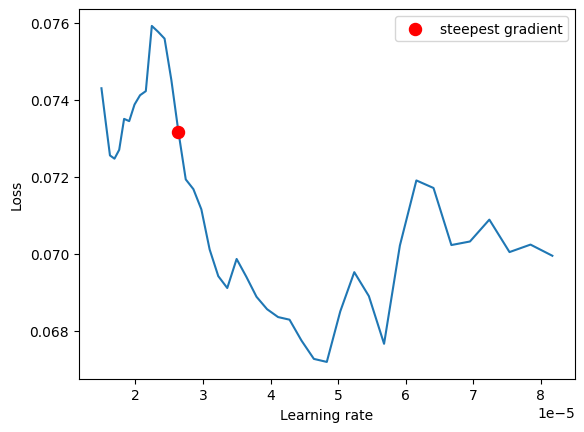

In [ ]:
# from torch_lr_finder import LRFinder

# test_model = deepcopy(new_model).to(device)
# optimizer = torch.optim.Adam(test_model.parameters(), lr=0.00001)

# lr_finder = LRFinder(test_model, optimizer, criterion, device=device)
# lr_finder.range_test(train_dataloader, end_lr=0.0001, num_iter=58, step_mode="exp")

# lr_finder.plot(log_lr=False)

# lr_finder.reset()

In [ ]:
import torch
from io import BytesIO

def get_model_size(model):
    buffer = BytesIO()
    torch.save(model.state_dict(), buffer)
    size_in_mb = buffer.tell() / (1024 * 1024)
    return size_in_mb

# Get the size of the model weights for new_model and unfreeze_model
new_model_size = get_model_size(new_model)
unfreeze_model_size = get_model_size(unfreeze_model)

print(f"Size of new_model weights: {new_model_size:.2f} MB")
print(f"Size of unfreeze_model weights: {unfreeze_model_size:.2f} MB")



Size of new_model weights: 90.27 MB
Size of unfreeze_model weights: 90.27 MB


In [ ]:
torch.save(new_model.state_dict(), 'resnet50_freeze.pth')
torch.save(unfreeze_model.state_dict(), 'resnet50_unfreeze.pth')

In [ ]:
#model.load_state_dict(torch.load('best_model_weights.pth'))
#model.to(device)

# STUDENT'S REPORT

Please write a short report describing the steps you took to improve quality. It should be at least a short paragraph with 3-5 sentences and, optionally, any relevant numbers/charts, but there's no upper limit.

Here's what i did: <YOUR TEXT>

## The baseline shows the original code for the fine tunning without any modifications.
## For updates, we add early stop to save the best epoch. Then by adjusting image gesture for augmentation and by finding best lr to test different lr.
## After reaching the limit of ResNet18 we changed to ResNet50 and did all above again.


|<font size="3">Method</font>|<font size="3">Accuracy in 'freeze'</font>|<font size="3">Accuracy in 'unfreeze'</font>|<font size="3">Macro Accuracy in 'freeze'</font> |<font size="3">Macro Accuracy in 'Unfreeze'</font>|
|----|----|----|----|----|
|<font size="5">Baseline</font>|<font size="5">87.41%</font>|<font size="5">89.92%</font>|<font size="5">73.08%</font>|<font size="5">83.19%</font>|
|<font size="5"> + Early stop</font>|||||
|<font size="5"> + Image augmentation</font>|<font size="5">87.38%</font>|<font size="5">90.05%</font>|<font size="5">77.20%</font>|<font size="5">86.37%</font>|
|<font size="5"> + Hyperparameter</font>|<font size="5">87.74%</font>|<font size="5">90.71%</font>|<font size="5">75.06%</font>|<font size="5">87.34%</font>|
|<font size="5"> + Resnet50</font>|<font size="5">90.68%</font>|<font size="5">92.12%</font>|<font size="5">83.55%</font>|<font size="5">90.41%</font>|

# Bonus task __(optional. 2 more points)__:

Notice that accuracy varies across breeds. Build confusion Propose improvements to the model finetuning process to improve minimal accuracy levels for all classes. Show the model runs.
Measure the improvement in terms of minimal accuracy and micro-averaged accuracy.

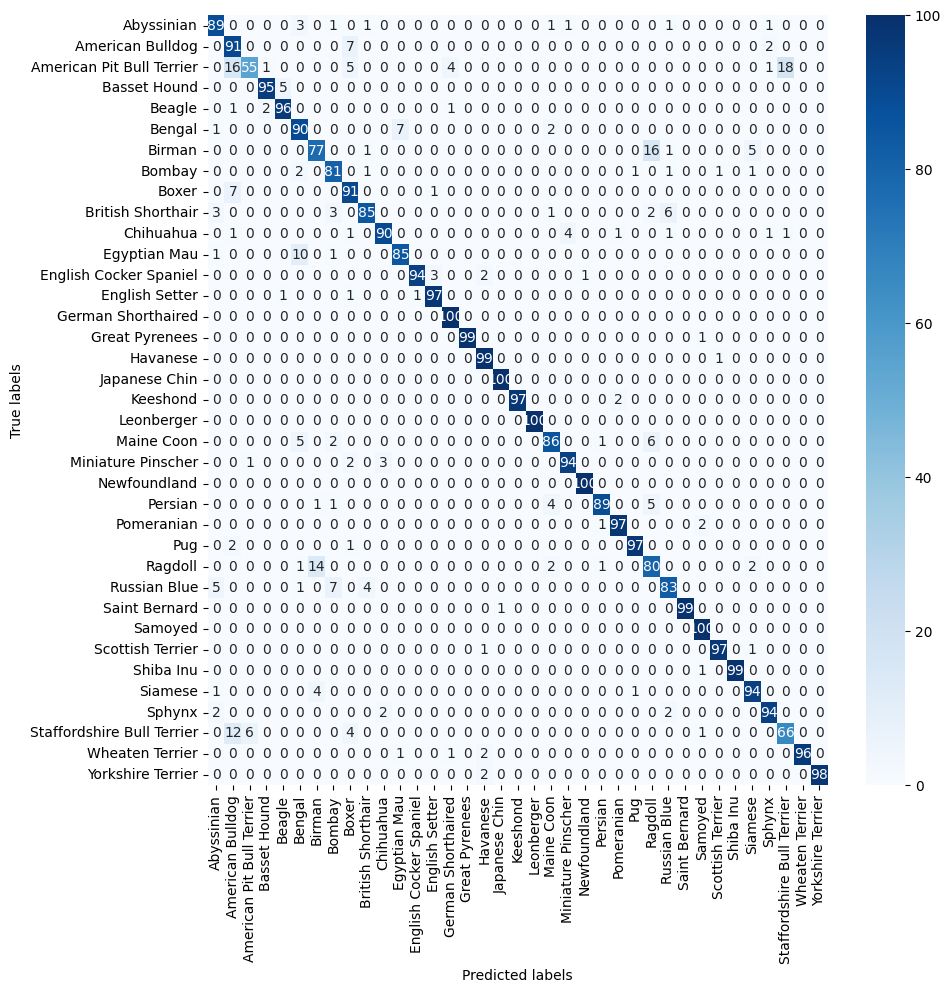

In [ ]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

Y_pred = torch.argmax(Y_probs, axis=1)
cm = confusion_matrix(Y_true, Y_pred)

plt.figure(figsize=(10,10))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=train_dataset.classes, yticklabels=train_dataset.classes)
plt.xlabel("Predicted labels")
plt.ylabel("True labels")
plt.show()



In [ ]:
sums = cm.sum(axis=1)
errors = cm / sums[:, None]
np.fill_diagonal(errors, 0)

num_top_errors = 50
top_errors = np.dstack(np.unravel_index(np.argsort(errors.ravel())[-num_top_errors:][::-1], errors.shape))[0]

true_labels = [train_dataset.classes[i] for i, j in top_errors]
predicted_labels = [train_dataset.classes[j] for i, j in top_errors]
counts = [cm[i, j] for i, j in top_errors]

error_df = pd.DataFrame({
    'True Label': true_labels,
    'Predicted Label': predicted_labels,
    'Count': counts
})
print(error_df)

                    True Label             Predicted Label  Count
0    American Pit Bull Terrier  Staffordshire Bull Terrier     18
1    American Pit Bull Terrier            American Bulldog     16
2                       Birman                     Ragdoll     16
3                      Ragdoll                      Birman     14
4   Staffordshire Bull Terrier            American Bulldog     12
5                 Egyptian Mau                      Bengal     10
6                        Boxer            American Bulldog      7
7             American Bulldog                       Boxer      7
8                       Bengal                Egyptian Mau      7
9                 Russian Blue                      Bombay      7
10  Staffordshire Bull Terrier   American Pit Bull Terrier      6
11                  Maine Coon                     Ragdoll      6
12           British Shorthair                Russian Blue      6
13                Basset Hound                      Beagle      5
14        

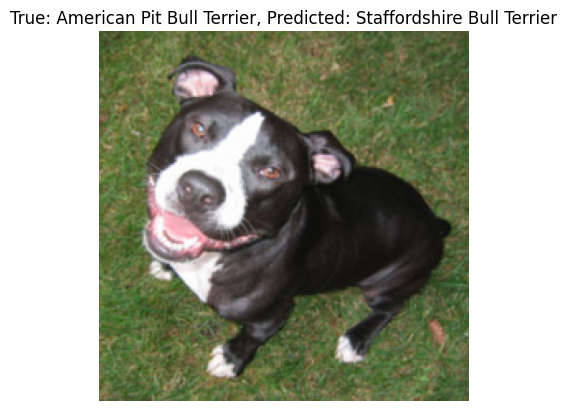

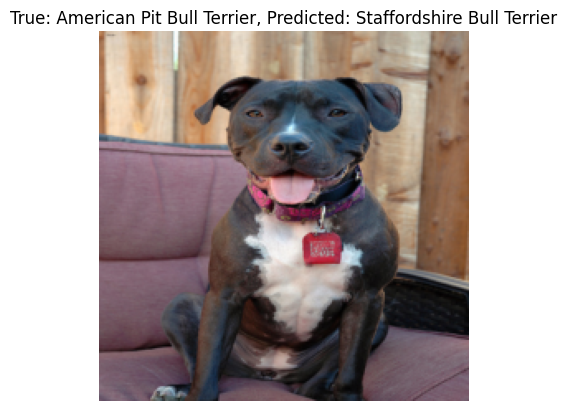

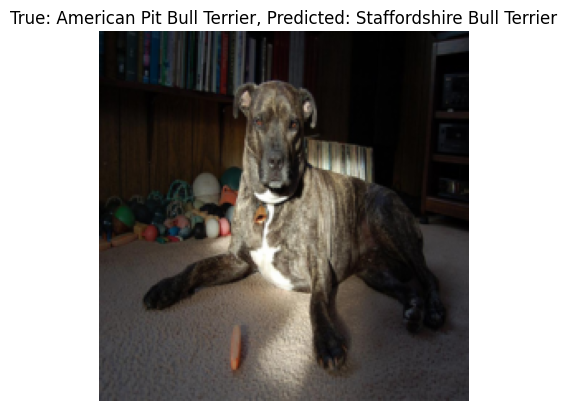

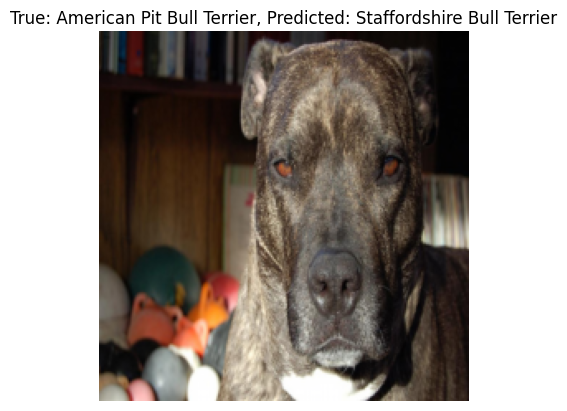

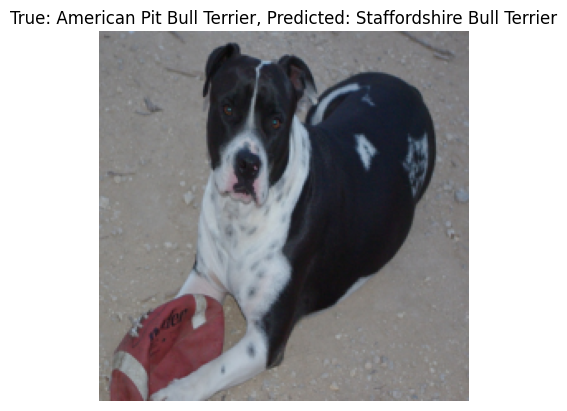

...

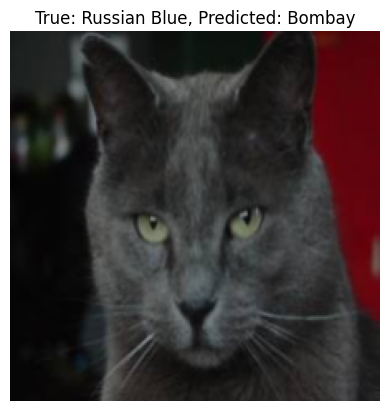

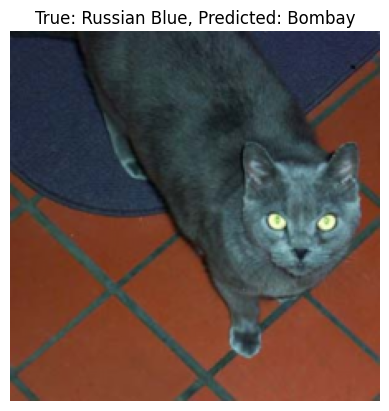

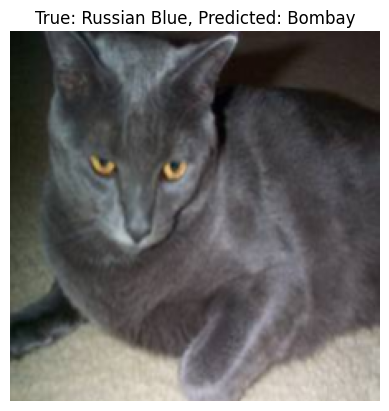

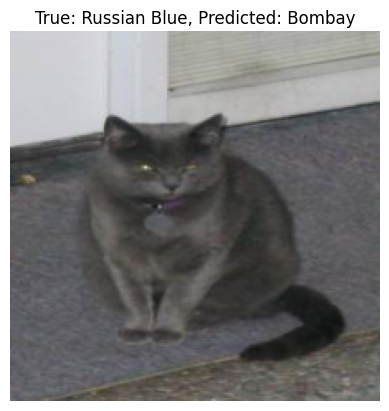

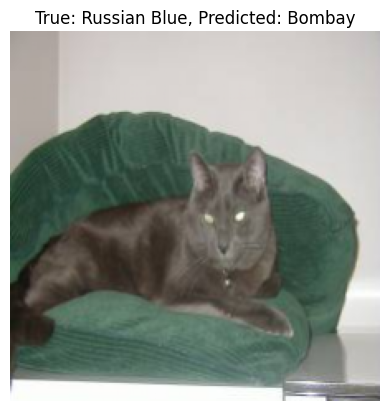

In [ ]:
# Plot the most wrong predictions (considering the top 10 from the previous extraction)
for i, j in top_errors[:10]:
    idxs = np.where((Y_true == i) & (Y_pred == j))[0]
    for idx in idxs:
        img_tensor, _ = test_dataset[idx]
        img_tensor = img_tensor.permute(1, 2, 0)  # C x H x W -> H x W x C
        mean = torch.tensor([0.485, 0.456, 0.406])
        std = torch.tensor([0.229, 0.224, 0.225])
        img = img_tensor * std + mean
        img = np.clip(img.numpy(), 0, 1)

        plt.figure()
        plt.imshow(img)
        plt.title(f"True: {train_dataset.classes[i]}, Predicted: {train_dataset.classes[j]}")
        plt.axis('off')
        plt.show()

In [ ]:
def compute_brightness(image):
    hsv = Image.fromarray(np.array(image)).convert('HSV')
    v = np.array(hsv)[:,:,2]
    return np.mean(v)
def compute_saturation(image):
    hsv = Image.fromarray(np.array(image)).convert('HSV')
    s = np.array(hsv)[:,:,1]
    return np.mean(s)
def compute_contrast(image):
    return np.std(image)
brightness_vals = []
saturation_vals = []
contrast_vals = []

for img, _ in train_dataset:
    img = transforms.functional.to_pil_image(img)

    brightness_vals.append(compute_brightness(img))
    saturation_vals.append(compute_saturation(img))
    contrast_vals.append(compute_contrast(img))

mean_brightness = np.mean(brightness_vals)
std_brightness = np.std(brightness_vals)

mean_saturation = np.mean(saturation_vals)
std_saturation = np.std(saturation_vals)

mean_contrast = np.mean(contrast_vals)
std_contrast = np.std(contrast_vals)


In [ ]:
mean_brightness,std_brightness,mean_saturation,std_saturation,mean_contrast,std_contrast

(185.17447532511648,
 11.034242055726443,
 160.28502178852182,
 17.26959537037812,
 73.59014634765438,
 3.865580223737954)

In [ ]:
train_transform = transforms.Compose([
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(15),
    transforms.RandomResizedCrop(224, scale=(0.8, 1.0)),
    transforms.ColorJitter(brightness=0.06, contrast=0.05, saturation=0.10),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406],
                         [0.229, 0.224, 0.225])
])

test_transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Resize((224, 224), antialias=True),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

# create dataloaders to repack the datasets' data into batches
# read more

batch_size = 64
train_dataloader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_dataloader = torch.utils.data.DataLoader(test_dataset, batch_size=batch_size, shuffle=False)
print("dataloader sizes:", len(train_dataloader), len(test_dataloader))

dataloader sizes: 58 58


  0%|          | 0/58 [00:00<?, ?it/s]

Learning rate search finished. See the graph with {finder_name}.plot()
LR suggestion: steepest gradient
Suggested LR: 4.16E-05


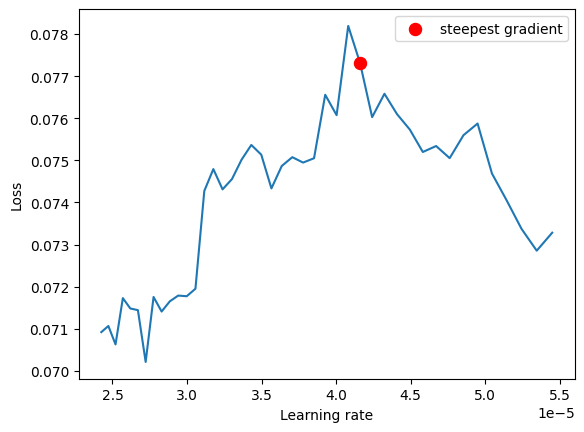

In [ ]:
from torch_lr_finder import LRFinder

test_model = deepcopy(new_model).to(device)
optimizer = torch.optim.Adam(test_model.parameters(), lr=0.00002)

lr_finder = LRFinder(test_model, optimizer, criterion, device=device)
lr_finder.range_test(train_dataloader, end_lr=0.00006, num_iter=58, step_mode="exp")

lr_finder.plot(log_lr=False)

lr_finder.reset()

In [ ]:
new_model = deepcopy(model).to(device)

for param in new_model.parameters():
    param.requires_grad = False

num_classes = len(train_dataset.classes)
print(new_model.fc.in_features, num_classes)
new_model.fc = torch.nn.Linear(new_model.fc.in_features, num_classes).to(device)

for param in new_model.fc.parameters():
    param.requires_grad = True

print(device)
print(new_model.fc.weight.device)

assert all(not p.requires_grad for p in new_model.parameters() if p not in set(new_model.fc.parameters()))
assert new_model.fc.out_features == len(train_dataset.classes)
#assert new_model.fc.weight.device == device, f"new_model.fc must be on {device}"
assert new_model.fc.weight.requires_grad

criterion = torch.nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(new_model.parameters(), lr=6.36E-04)#

2048 37
cuda
cuda:0


In [ ]:
# train the finetuning model in a standard training loop.
num_epochs = 50  # Adjust number of epochs if needed

history = defaultdict(list)
patience = 5
early_stop_counter = 0
best_accuracy = 0.0
best_model_wts = deepcopy(new_model.state_dict())

history = defaultdict(list)
for epoch in range(num_epochs):
    start_time = time.time()

    new_model.train()
    train_losses = []
    pbar = tqdm(train_dataloader, leave=False)
    for x_batch, y_batch in pbar:

        # calculate model predictions, calculate loss, make optimizer step
        x_batch, y_batch = x_batch.to(device), y_batch.to(device)
        optimizer.zero_grad()
        y_pred = new_model(x_batch)
        loss = criterion(y_pred, y_batch)
        loss.backward()
        optimizer.step()

        train_losses.append(loss.item())
        pbar.desc = f"Train. Ep:{epoch}, Loss:{np.mean(train_losses[-10:]):.5f}"

    new_model.eval()
    val_losses = []
    val_cnt, val_correct = 0, 0
    pbar = tqdm(test_dataloader, leave=False)
    for x_batch, y_batch in pbar:

        # get model predictions, measure loss, collect data for accuracy calc
        x_batch, y_batch = x_batch.to(device), y_batch.to(device)
        y_pred = new_model(x_batch)
        loss = criterion(y_pred, y_batch)

        val_losses.append(loss.item())
        val_cnt += y_batch.shape[0]
        val_correct += (y_batch.cuda() == torch.argmax(y_pred, dim=1)).sum().item()
        pbar.desc = f"Valid. Ep:{epoch}, Loss:{np.mean(val_losses):.5f}"

    train_loss = np.mean(train_losses)
    val_loss = np.mean(val_losses)
    accuracy = val_correct / val_cnt
    history['train_loss'].append(train_loss)
    history['val_loss'].append(val_loss)
    history['accuracy'].append(accuracy)
    print(f"Ep.{epoch:>2}: {train_loss=:.5f}  {val_loss=:.5f}  {accuracy=:.2%}  epoch_time={time.time() - start_time:.1f}s")

    if accuracy > best_accuracy:
        best_accuracy = accuracy
        best_model_wts = deepcopy(new_model.state_dict())
        early_stop_counter = 0
    else:
        early_stop_counter += 1
        if early_stop_counter >= patience:
            print("Early stopping triggered.")
            break

new_model.load_state_dict(best_model_wts)

print(f"Best Accuracy = {max(history['accuracy']):.2%}")

  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep. 0: train_loss=2.67676  val_loss=1.98464  accuracy=79.80%  epoch_time=53.5s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep. 1: train_loss=1.37181  val_loss=1.21555  accuracy=85.23%  epoch_time=54.3s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep. 2: train_loss=0.80820  val_loss=0.86867  accuracy=86.24%  epoch_time=54.2s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep. 3: train_loss=0.55946  val_loss=0.70211  accuracy=87.54%  epoch_time=53.5s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep. 4: train_loss=0.42616  val_loss=0.58991  accuracy=88.47%  epoch_time=53.4s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep. 5: train_loss=0.34372  val_loss=0.52360  accuracy=88.99%  epoch_time=54.1s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep. 6: train_loss=0.29427  val_loss=0.48257  accuracy=89.07%  epoch_time=53.7s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep. 7: train_loss=0.25523  val_loss=0.44308  accuracy=89.32%  epoch_time=54.1s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep. 8: train_loss=0.22028  val_loss=0.41736  accuracy=89.75%  epoch_time=53.2s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep. 9: train_loss=0.19775  val_loss=0.40583  accuracy=89.78%  epoch_time=53.4s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep.10: train_loss=0.18086  val_loss=0.38708  accuracy=89.75%  epoch_time=53.8s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep.11: train_loss=0.16187  val_loss=0.38107  accuracy=89.92%  epoch_time=54.0s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep.12: train_loss=0.14934  val_loss=0.36285  accuracy=90.24%  epoch_time=53.5s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep.13: train_loss=0.13562  val_loss=0.36151  accuracy=90.19%  epoch_time=53.0s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep.14: train_loss=0.12415  val_loss=0.35381  accuracy=90.08%  epoch_time=53.8s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep.15: train_loss=0.11557  val_loss=0.34613  accuracy=90.35%  epoch_time=54.3s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep.16: train_loss=0.10970  val_loss=0.33663  accuracy=90.54%  epoch_time=53.2s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep.17: train_loss=0.10003  val_loss=0.33783  accuracy=90.43%  epoch_time=54.1s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep.18: train_loss=0.09151  val_loss=0.34031  accuracy=90.16%  epoch_time=53.8s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep.19: train_loss=0.08708  val_loss=0.32437  accuracy=90.57%  epoch_time=53.3s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep.20: train_loss=0.08209  val_loss=0.32893  accuracy=90.41%  epoch_time=53.8s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep.21: train_loss=0.07887  val_loss=0.32019  accuracy=90.73%  epoch_time=54.2s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep.22: train_loss=0.07504  val_loss=0.31465  accuracy=90.65%  epoch_time=52.9s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep.23: train_loss=0.07019  val_loss=0.31976  accuracy=90.62%  epoch_time=54.1s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep.24: train_loss=0.06861  val_loss=0.31549  accuracy=90.49%  epoch_time=53.6s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep.25: train_loss=0.06356  val_loss=0.30387  accuracy=90.71%  epoch_time=54.2s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep.26: train_loss=0.06119  val_loss=0.31087  accuracy=90.68%  epoch_time=53.4s
Early stopping triggered.
Best Accuracy = 90.73%


In [ ]:
unfreeze_model = deepcopy(new_model).to(device)
# Continue training with all layers involved

# <YOUR CODE to make all layers trainable>

for param in unfreeze_model.parameters():
    param.requires_grad = True

assert all (p.requires_grad for p in unfreeze_model.parameters())

optimizer = torch.optim.Adam(unfreeze_model.parameters(), lr= 4.16E-05)  # reduce LR to avoid explosion

# train the finetuning model in a standard training loop.
num_epochs = 50  # Adjust number of epochs if needed

history = defaultdict(list)
patience = 5
early_stop_counter = 0
best_accuracy = 0.0
best_model_wts = deepcopy(unfreeze_model.state_dict())

history = defaultdict(list)
for epoch in range(num_epochs):
    start_time = time.time()

    unfreeze_model.train()
    train_losses = []
    pbar = tqdm(train_dataloader, leave=False)
    for x_batch, y_batch in pbar:

        # calculate model predictions, calculate loss, make optimizer step
        x_batch, y_batch = x_batch.to(device), y_batch.to(device)
        optimizer.zero_grad()
        y_pred = unfreeze_model(x_batch)
        loss = criterion(y_pred, y_batch)
        loss.backward()
        optimizer.step()

        train_losses.append(loss.item())
        pbar.desc = f"Train. Ep:{epoch}, Loss:{np.mean(train_losses[-10:]):.5f}"

    unfreeze_model.eval()
    val_losses = []
    val_cnt, val_correct = 0, 0
    pbar = tqdm(test_dataloader, leave=False)
    for x_batch, y_batch in pbar:

        # get model predictions, measure loss, collect data for accuracy calc
        x_batch, y_batch = x_batch.to(device), y_batch.to(device)
        y_pred = unfreeze_model(x_batch)
        loss = criterion(y_pred, y_batch)

        val_losses.append(loss.item())
        val_cnt += y_batch.shape[0]
        val_correct += (y_batch.cuda() == torch.argmax(y_pred, dim=1)).sum().item()
        pbar.desc = f"Valid. Ep:{epoch}, Loss:{np.mean(val_losses):.5f}"

    train_loss = np.mean(train_losses)
    val_loss = np.mean(val_losses)
    accuracy = val_correct / val_cnt
    history['train_loss'].append(train_loss)
    history['val_loss'].append(val_loss)
    history['accuracy'].append(accuracy)
    print(f"Ep.{epoch:>2}: {train_loss=:.5f}  {val_loss=:.5f}  {accuracy=:.2%}  epoch_time={time.time() - start_time:.1f}s")


    if accuracy > best_accuracy:
        best_accuracy = accuracy
        best_model_wts = deepcopy(unfreeze_model.state_dict())
        early_stop_counter = 0
    else:
        early_stop_counter += 1
        if early_stop_counter >= patience:
            print("Early stopping triggered.")
            break

unfreeze_model.load_state_dict(best_model_wts)

print(f"Best Accuracy = {max(history['accuracy']):.2%}")

  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep. 0: train_loss=0.05064  val_loss=0.28547  accuracy=91.20%  epoch_time=65.0s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep. 1: train_loss=0.02389  val_loss=0.29681  accuracy=91.47%  epoch_time=65.4s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep. 2: train_loss=0.01139  val_loss=0.29094  accuracy=91.52%  epoch_time=65.1s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep. 3: train_loss=0.01140  val_loss=0.28128  accuracy=91.85%  epoch_time=66.2s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep. 4: train_loss=0.00505  val_loss=0.29954  accuracy=91.91%  epoch_time=65.6s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep. 5: train_loss=0.00653  val_loss=0.30216  accuracy=91.52%  epoch_time=65.3s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep. 6: train_loss=0.00588  val_loss=0.30313  accuracy=91.33%  epoch_time=66.3s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep. 7: train_loss=0.00478  val_loss=0.30742  accuracy=91.41%  epoch_time=66.4s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep. 8: train_loss=0.00428  val_loss=0.31192  accuracy=91.55%  epoch_time=65.9s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep. 9: train_loss=0.00254  val_loss=0.30234  accuracy=92.29%  epoch_time=66.2s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep.10: train_loss=0.00203  val_loss=0.30734  accuracy=92.18%  epoch_time=65.8s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep.11: train_loss=0.00259  val_loss=0.30582  accuracy=92.23%  epoch_time=66.2s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep.12: train_loss=0.00220  val_loss=0.32845  accuracy=91.71%  epoch_time=65.6s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep.13: train_loss=0.00135  val_loss=0.31940  accuracy=92.01%  epoch_time=64.9s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep.14: train_loss=0.00149  val_loss=0.31019  accuracy=92.42%  epoch_time=66.2s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep.15: train_loss=0.00172  val_loss=0.32872  accuracy=91.85%  epoch_time=66.6s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep.16: train_loss=0.00284  val_loss=0.32089  accuracy=92.10%  epoch_time=66.0s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep.17: train_loss=0.00101  val_loss=0.32288  accuracy=91.99%  epoch_time=65.2s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep.18: train_loss=0.00103  val_loss=0.32614  accuracy=92.07%  epoch_time=65.8s


  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

Ep.19: train_loss=0.00124  val_loss=0.33001  accuracy=91.77%  epoch_time=66.1s
Early stopping triggered.
Best Accuracy = 92.42%


In [ ]:
# Predicting breeds with finetuned model

Y_probs, Y_true = [], []
for x_batch, y_batch in tqdm(test_dataloader):
    with torch.no_grad():
        prediction = unfreeze_model(x_batch.to(device))
        probs = torch.nn.functional.softmax(prediction, dim=-1).cpu()
        Y_true.append(y_batch)
        Y_probs.append(probs)

Y_probs = torch.cat(Y_probs, axis=0)
Y_true = torch.cat(Y_true)
Y_true.shape, Y_probs.shape

# Measure Top1 prediction accuracy for each class

results_list = {}
total, correct = 0, 0

for i, cl in enumerate(test_dataset.classes):
    class_preds = np.where(Y_true == i)
    probs1 = Y_probs[class_preds].mean(axis=0).numpy()
    acc1 = probs1[i]
    class_stats = {"true_label":cl, 'acc1': acc1}
    total += class_preds[0].shape[0]
    correct += class_preds[0].shape[0] * acc1
    results_list[cl] = acc1

df = pd.Series(results_list).to_frame('acc1').sort_values('acc1', ascending=False)
df.style.format('{:.2%}', subset=['acc1'])


  0%|          | 0/58 [00:00<?, ?it/s]

,acc1
Japanese Chin,99.83%
Samoyed,99.46%
German Shorthaired,99.41%
Shiba Inu,99.13%
Leonberger,99.05%
Newfoundland,98.33%
Great Pyrenees,97.93%
Havanese,97.85%
Saint Bernard,97.84%
Keeshond,97.58%


In [ ]:
print(f"Overall Accuracy = {correct / total:.2%}")  # macro-averaged accuracy

Overall Accuracy = 91.02%


| Breed                        | Improved Result | Previous Result | Improvement   |
|------------------------------|--------------|---------------|--------------|
| Japanese Chin                | 99.83%       | 99.66%        | +0.17%       |
| Samoyed                      | 99.46%       | 99.44%        | +0.02%       |
| German Shorthaired           | 99.41%       | 99.37%        | +0.04%       |
| Shiba Inu                    | 99.13%       | 99.18%        | -0.05%       |
| Leonberger                   | 99.05%       | 99.46%        | -0.41%       |
| Newfoundland                 | 98.33%       | 98.20%        | +0.13%       |
| Great Pyrenees               | 97.93%       | 98.37%        | -0.44%       |
| Havanese                     | 97.85%       | 97.40%        | +0.45%       |
| Saint Bernard                | 97.84%       | 97.14%        | +0.70%       |
| Keeshond                     | 97.58%       | 98.24%        | -0.66%       |
| Scottish Terrier             | 97.56%       | 97.35%        | +0.21%       |
| Pomeranian                   | 96.71%       | 95.62%        | +1.09%       |
| Pug                          | 96.70%       | 96.16%        | +0.54%       |
| Yorkshire Terrier            | 96.65%       | 97.18%        | -0.53%       |
| English Setter               | 95.91%       | 96.15%        | -0.24%       |
| English Cocker Spaniel       | 95.87%       | 94.07%        | +1.80%       |
| Bombay                       | 93.39%       | 91.81%        | +1.58%       |
| American Bulldog             | 93.30%       | 88.50%        | +4.80%       |
| Basset Hound                 | 92.54%       | 93.02%        | -0.48%       |
| Beagle                       | 92.42%       | 94.67%        | -2.25%       |
| Wheaten Terrier              | 92.28%       | 94.46%        | -2.18%       |
| Miniature Pinscher           | 91.53%       | 91.54%        | -0.01%       |
| Sphynx                       | 91.13%       | 92.22%        | -1.09%       |
| Boxer                        | 89.66%       | 90.49%        | -0.83%       |
| Abyssinian                   | 89.45%       | 87.12%        | +2.33%       |
| Siamese                      | 89.37%       | 90.49%        | -1.12%       |
| Bengal                       | 89.04%       | 87.91%        | +1.13%       |
| Chihuahua                    | 88.95%       | 86.96%        | +1.99%       |
| Maine Coon                   | 88.51%       | 83.66%        | +4.85%       |
| Egyptian Mau                 | 87.79%       | 87.09%        | +0.70%       |
| British Shorthair            | 84.85%       | 82.64%        | +2.21%       |
| Persian                      | 84.70%       | 87.17%        | -2.47%       |
| Russian Blue                 | 82.29%       | 79.78%        | +2.51%       |
| Birman                       | 81.56%       | 74.54%        | +7.02%       |
| Ragdoll                      | 76.98%       | 77.08%        | -0.10%       |
| Staffordshire Bull Terrier   | 69.87%       | 66.99%        | +2.88%       |
| American Pit Bull Terrier    | 50.22%       | 51.69%        | -1.47%       |

## We propose to adjust the light for images based on mean and std of contrast so on
## For least 10 minimal accuracy, 7 categories improved, 3 decreased
## Micro accuracy from 92.12% to 92.42%
## Macro accuracy from 90.41% to 91.02%

# EXTRA STUFF:


## Links:    
- [The Building Blocks of Interpretability](https://distill.pub/2018/building-blocks/)
- [Activations Atlas](https://distill.pub/2019/activation-atlas/)
- more models from https://github.com/huggingface/pytorch-image-models
- Papers with code: benchmarks and model references. https://paperswithcode.com/sota/image-classification-on-imagenet